<a href="https://colab.research.google.com/github/ChenHsieh/Peanut-Root-Analysis/blob/main/Vision_API_label_extraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Using Google Vision API

This is an upgraded Python revision of [this notebook](https://github.com/GoogleCloudPlatform/training-data-analyst/blob/master/CPB100/lab4c/mlapis.ipynb).

This notebook originally was being processed using DataLab on the Google Cloud Platform.  This particular incarnation of the notebook is for running on Google Colaboratory which I am trying out for the first time.

### Security

First things first - we need to authenticate against the Google Cloud APIs.

#### Getting a Google API Credential.

First, visit <a href="http://console.cloud.google.com/apis">API console</a>, choose "Credentials" on the left-hand menu.  Choose "Create Credentials" and generate an API key for your application. You should probably restrict it by IP address to prevent abuse, but for now, just  leave that field blank and delete the API key after trying out this demo.

Then, when you have your key, you will enter it in this first executable cell:

In [ ]:
import getpass

APIKEY = getpass.getpass()

··········


## Mount your google drive
You can check the data files at the left panel by clicking the folder icon

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install --upgrade pip
!pip install --upgrade google-api-python-client google-cloud-core google-api-core
# update may cause some issue
# https://github.com/googleapis/google-cloud-python/issues/10471

     |████████████████████████████████| 1.5MB 5.4MB/s 
  Found existing installation: pip 19.3.1
    Uninstalling pip-19.3.1:
      Successfully uninstalled pip-19.3.1
     |████████████████████████████████| 61 kB 3.1 MB/s 
     |████████████████████████████████| 91 kB 7.3 MB/s 
  Attempting uninstall: google-api-core
    Found existing installation: google-api-core 1.16.0
    Uninstalling google-api-core-1.16.0:
      Successfully uninstalled google-api-core-1.16.0
  Attempting uninstall: google-api-python-client
    Found existing installation: google-api-python-client 1.7.12
    Uninstalling google-api-python-client-1.7.12:
      Successfully uninstalled google-api-python-client-1.7.12
  Attempting uninstall: google-cloud-core
    Found existing installation: google-cloud-core 1.0.3
    Uninstalling google-cloud-core-1.0.3:
      Successfully uninstalled google-cloud-core-1.0.3
ERROR: After October 2020 you may experience errors when installing or updating packages. This is because 

In [ ]:
# get all image file names in the specified folder
import os
from os.path import join, dirname
from pathlib import Path
# using photo from shelter 1 for testing
## specify the dir in the mounted google drive

dir = '/content/drive/My Drive/Root_Photo/shelter 4'
## load all image file name in the dir 
images = [name for name in os.listdir(dir) if
          os.path.isfile(os.path.join(dir, name)) & name.startswith('DSC')]
len(images)

241

In [ ]:
# Running Vision API
from base64 import b64encode
from google.colab import files
# prepare a function for image encoding for API
import base64
from googleapiclient.discovery import build
import json
ENCODING = 'utf-8'
# Pass the image data to an encoding function.
def encode_image(image):
  image_content = image.read()
  base64_bytes = b64encode(image_content)
  base64_string = base64_bytes.decode(ENCODING)
  return base64_string
# change current working directory and show one of the file
import os
os.chdir(dir)
from IPython.display import Image, display
# display(Image(images[1], width = "300"))

In [ ]:
res_dict = {}
file_count = 0
for image_file_name in images:
  file_count += 1
  print("### Processing image number ###")
  print(file_count)
  print("### sending image to API ###")
  image_file = open(image_file_name,"rb")
  print(image_file_name)
  encoded_image_str = encode_image(image_file)
  vservice = build('vision', 'v1', developerKey=APIKEY)
  request = vservice.images().annotate(body={
        'requests': [{
                'image': {
                    'content': encoded_image_str
                },
                'features': [{
                    'type': 'TEXT_DETECTION'
                }]
            }],
        })
  responses = request.execute(num_retries=3)
  print("#### detection result ####")
  print(responses['responses'][0]['textAnnotations'][0]['description'])
  res_dict[image_file_name] = responses
  json_file_name = image_file_name + ".json"
  with open(json_file_name, 'w') as jsonfile:
    json.dump(responses, jsonfile)
with open("shelter_result.json", 'w') as jsonfile:
  json.dump(res_dict, jsonfile)

Streaming output truncated to the last 5000 lines.
24 25
26
27 28
6.
9.
3.

### Processing image number ###
71
### sending image to API ###
DSC_0034.JPG
#### detection result ####
S4 R4_A69 4
8.
LO
6
10
11
12 13
14
15
16 17 18
19
20
21
22
23
24
25
26
27
28
6

### Processing image number ###
72
### sending image to API ###
DSC_0026_2.JPG
#### detection result ####
S4_R3_554CC 3
3
5
6.
8
96.
10
11
12
13
14
15 16 17
18 19
20
21
22
23
24
25 26 27
9.
5.

### Processing image number ###
73
### sending image to API ###
DSC_0033.JPG
#### detection result ####
S4_R4_A69 3
8.
OC
3
5
6 7
10
11
12 13
14 15
16 17 18 19
20
21
22
23
24 25
26
27
28
6.
9
3.

### Processing image number ###
74
### sending image to API ###
DSC_0037_2.JPG
#### detection result ####
S4_R3_ICGV 93305 3
8.
CO
23
3
4
5
7.
9.
10
11
12 13
14
15
16
17
18
19
20
21
22
24 25
26
27
6.

### Processing image number ###
75
### sending image to API ###
DSC_0036.JPG
#### detection result ####
S4 R2_264CC 3
LO
3
5
6.
7
8.
96-
10
11
12 13


In [ ]:
f = open("shelter1.txt","r")
lines = f.readlines()
lines = [rep.strip() for rep in lines]
new_list = [ rep[:-2].strip('-') for rep in lines]
geno_name_list = list(set(new_list))

In [ ]:
correct_count = 0
total_fail = 0

for image_file_name in images:
  print(image_file_name)
  try:
    label = res_dict[image_file_name]['responses'][0]['textAnnotations'][0]['description']
  except:
    total_fail += 1
    print("res wrong")
    continue
  detection_result = 0
  for geno_name in geno_name_list:
    if geno_name in label:
      correct_count += 1
      detection_result = 1
      print("goal")
      print(geno_name)

      break
  if detection_result == 0:
    print("fail")
    print(label)
    # responses['responses'][0]['textAnnotations'][1:]
print("total_fail")
print(total_fail)
print("correct_count")
print(correct_count)

In [ ]:
! pip3 install fuzzywuzzy
! pip3 install python-Levenshtein

     |████████████████████████████████| 48 kB 3.2 MB/s 
  Created wheel for python-Levenshtein: filename=python_Levenshtein-0.12.0-cp36-cp36m-linux_x86_64.whl size=144790 sha256=3a421d8532818cba8eda5f86c65611d01c509406e0ae3f0380b6f6170878aba7
  Stored in directory: /root/.cache/pip/wheels/79/c3/a1/cbdd8b154234b3e571d121b65be7d53354cc77e223e8f271c8
Successfully built python-Levenshtein


In [ ]:
from fuzzywuzzy import fuzz
from fuzzywuzzy import process 
# for geno_name in geno_name_list:
#   Str1 = res_dict['DSC_0081.JPG']['responses'][0]['textAnnotations'][0]['description']
#   Str2 = geno_name
#   Token_Sort_Ratio = fuzz.token_sort_ratio(Str1,Str2)
#   str2Match = "apple inc"
query = res_dict['DSC_0081.JPG']['responses'][0]['textAnnotations'][0]['description']
strOptions = geno_name_list
Ratios = process.extract(query,strOptions)
print("List of ratios: ")
print(Ratios, '\n')
print("Best among the above list: ",process.extractOne(query, strOptions))


List of ratios: 
[('ISATAF-3', 86), ('ICG 4440', 45), ('C495-1-1', 45), ('ICG 884', 39), ('C431-1-7', 34)] 

Best among the above list:  ('ISATAF-3', 86)


In [ ]:
print(query)

SI R4 049
の
3.
4.
9-



[[1734  551]
 [2493  839]
 [2452  947]
 [1693  659]]
[[107 222]
 [106 256]
 [ 48 255]
 [ 49 221]]
[[ 108 1242]
 [ 108 1277]
 [  58 1277]
 [  58 1242]]


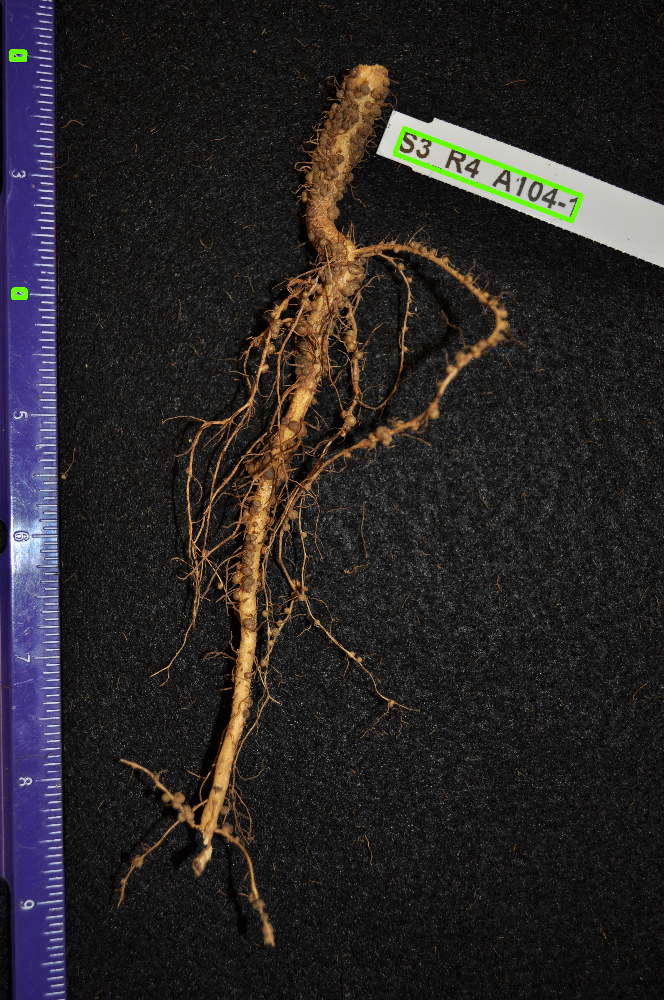

In [ ]:
# show bounding box
from google.colab.patches import cv2_imshow
import cv2
img = cv2.imread(images[0])
each_result = responses['responses'][0]['textAnnotations'][1:]
for result in each_result:
  coordinate_list = result['boundingPoly']['vertices']
  point_list = []
  for coordinate in coordinate_list:
    x = coordinate['x']
    y = coordinate['y']
    point = [x, y]
    point_list.append(point)
  cnt = np.array(point_list)
  print(cnt)
  cv2.drawContours(img, [cnt], 0, (0, 255, 100), 20)
cv2_imshow(img)

As a matter of interest - we can crop to the face with the following code:
```
xlow = ylow = 100000
xhigh = yhigh = -1
for point in responses['responses'][0]['faceAnnotations'][0]['boundingPoly']['vertices']:
    x = point['x']
    y = point['y']
    if x < xlow: xlow = x
    if y < ylow: ylow = y
    if x > xhigh: xhigh = x
    if y > yhigh: yhigh = y

from PIL import Image
import urllib.request

url = "https://raw.githubusercontent.com/jeffreyrnorton/Notebooks_MachineLearning/master/images/14295.jpg"
response = urllib.request.urlretrieve(url, "tmp/i.jpg")
img = Image.open("tmp/i.jpg")
img2 = img.crop((xlow, ylow, xhigh, yhigh))
img2.save("tmp/img2.jpg")
```


<h2> Clean up </h2>

Remember to delete the API key by visiting <a href="http://console.cloud.google.com/apis">API console</a>.

If necessary, commit all your notebooks to git.

If you are running Datalab on a Compute Engine VM or delegating to one, remember to stop or shut it down so that you are not charged.


Copyright 2018 Google Inc.
Licensed under the Apache License, Version 2.0 (the "License"); you may not use this file except in compliance with the License. You may obtain a copy of the License at
http://www.apache.org/licenses/LICENSE-2.0
Unless required by applicable law or agreed to in writing, software distributed under the License is distributed on an "AS IS" BASIS, WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied. See the License for the specific language governing permissions and limitations under the License.